In [61]:
#import pandas to load the datasets into dataframes
import pandas as pd

# Importing the Seaborn library for advanced data visualization (as sns)
import seaborn as sns

# Importing the Matplotlib library for basic plotting functionalities (as plt)
import matplotlib.pyplot as plt

In [62]:
# Matplotlib inline to visualize Matplotlib graphs
%matplotlib inline

# Configuration to set so that all the Seaborn figures come out with this size
%config Inlinebackend.figure_format= 'retina'

In [63]:
# Set the Seaborn context to "poster" for larger text and figures
sns.set_context("poster")

# Set the default figure size for Seaborn plots
sns.set(rc={"figure.figsize": (12., 6.)})

# Set the Seaborn style to "whitegrid" for a white background with gridlines
sns.set_style("whitegrid")

In [64]:
#Load datasets into dataframes with the following variables
cash_request = pd.read_csv("project_dataset/extract - cash request - data analyst.csv")
fees = pd.read_csv("project_dataset/extract - fees - data analyst - .csv")
#lexique = pd.read_excel("project_dataset/Lexique - Data Analyst.xlsx")

In [65]:
#show the cash request dataframe for quick understanding
cash_request.head()

,id,amount,status,created_at,updated_at,user_id,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,5,100.0,rejected,2019-12-10 19:05:21.596873+00,2019-12-11 16:47:42.40783+00,804.0,2019-12-11 16:47:42.405646+00,NaN,2020-01-09 19:05:21.596363+00,NaN,NaN,regular,NaN,NaN,NaN,NaN
1,70,100.0,rejected,2019-12-10 19:50:12.34778+00,2019-12-11 14:24:22.900054+00,231.0,2019-12-11 14:24:22.897988+00,NaN,2020-01-09 19:50:12.34778+00,NaN,NaN,regular,NaN,NaN,NaN,NaN
2,7,100.0,rejected,2019-12-10 19:13:35.82546+00,2019-12-11 09:46:59.779773+00,191.0,2019-12-11 09:46:59.777728+00,NaN,2020-01-09 19:13:35.825041+00,NaN,NaN,regular,NaN,NaN,NaN,NaN
3,10,99.0,rejected,2019-12-10 19:16:10.880172+00,2019-12-18 14:26:18.136163+00,761.0,2019-12-18 14:26:18.128407+00,NaN,2020-01-09 19:16:10.879606+00,NaN,NaN,regular,NaN,NaN,NaN,NaN
4,1594,100.0,rejected,2020-05-06 09:59:38.877376+00,2020-05-07 09:21:55.34008+00,7686.0,2020-05-07 09:21:55.320193+00,NaN,2020-06-05 22:00:00+00,NaN,NaN,regular,NaN,NaN,NaN,NaN


In [66]:
#show the fees dataframe for quick understanding
fees.head()

,id,cash_request_id,type,status,category,total_amount,reason,created_at,updated_at,paid_at,from_date,to_date,charge_moment
0,6537,14941.0,instant_payment,rejected,NaN,5.0,Instant Payment Cash Request 14941,2020-09-07 10:47:27.42315+00,2020-10-13 14:25:09.396112+00,2020-12-17 14:50:07.47011+00,NaN,NaN,after
1,6961,11714.0,incident,accepted,rejected_direct_debit,5.0,rejected direct debit,2020-09-09 20:51:17.998653+00,2020-10-13 14:25:15.537063+00,2020-12-08 17:13:10.45908+00,NaN,NaN,after
2,16296,23371.0,instant_payment,accepted,NaN,5.0,Instant Payment Cash Request 23371,2020-10-23 10:10:58.352972+00,2020-10-23 10:10:58.352994+00,2020-11-04 19:34:37.43291+00,NaN,NaN,after
3,20775,26772.0,instant_payment,accepted,NaN,5.0,Instant Payment Cash Request 26772,2020-10-31 15:46:53.643958+00,2020-10-31 15:46:53.643982+00,2020-11-19 05:09:22.500223+00,NaN,NaN,after
4,11242,19350.0,instant_payment,accepted,NaN,5.0,Instant Payment Cash Request 19350,2020-10-06 08:20:17.170432+00,2020-10-13 14:25:03.267983+00,2020-11-02 14:45:20.355598+00,NaN,NaN,after


In [67]:
#Checking if There is a row with a user ID and a deleted user ID
condition = (cash_request["deleted_account_id"].notna() == False) & (cash_request["user_id"].notna() == False)
             
for i in condition:
    if i == True:
        print("There is a row with a user ID and a deleted user ID")

In [68]:
# creating a dataframe to only get the users who have at least a loan with ironhack by discarding the rejected type of CR status

filter1 = (cash_request['status'] != "rejected")
filter2 = (cash_request['status'] != "transaction_declined")
filter3 = (cash_request['status'] != "canceled")
filter4 = (cash_request['status'] != "pending")
filter5 = (cash_request['status'] != "direct_debit_rejected")

filtered_df = filter1 & filter2 & filter3 & filter4 & filter5

filtered_df = cash_request[filtered_df]

filtered_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16490 entries, 5 to 23969
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          16490 non-null  int64  
 1   amount                      16490 non-null  float64
 2   status                      16490 non-null  object 
 3   created_at                  16490 non-null  object 
 4   updated_at                  16490 non-null  object 
 5   user_id                     15776 non-null  float64
 6   moderated_at                9006 non-null   object 
 7   deleted_account_id          715 non-null    float64
 8   reimbursement_date          16490 non-null  object 
 9   cash_request_received_date  15498 non-null  object 
 10  money_back_date             16226 non-null  object 
 11  transfer_type               16490 non-null  object 
 12  send_at                     12087 non-null  object 
 13  recovery_status             2509 non

In [69]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
5,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
11,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
13,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
43,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
48,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [70]:
#Reseting the index for further merge and groupbys
filtered_df = filtered_df.reset_index(drop=True)

In [71]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [72]:
#creating a cohorts dataframe to loop through later and insert corresponding cohort to a user_id
cohorts = filtered_df[["user_id", "created_at"]].groupby(by=["user_id"]).min()
cohorts.head()

,created_at
user_id,
47.0,2020-04-16 08:42:15.429083+00
52.0,2019-12-17 09:01:12.584634+00
53.0,2019-12-21 11:39:03.844436+00
66.0,2020-04-01 06:51:30.941429+00
68.0,2019-12-20 06:32:25.594841+00


In [73]:
#Creating a new column
filtered_df.insert(6, "Cohort", None, True)

In [74]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,Cohort,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,None,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,None,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,None,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,None,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,None,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [75]:
# Adding cohorts tags to every user_id
for index, userid in enumerate(filtered_df["user_id"]):
    try:
        date = cohorts["created_at"][userid][:7]
    except:
        continue
    else:
        filtered_df["Cohort"][index] = date

C:\Users\drago\AppData\Local\Temp\ipykernel_30376\2812059642.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  filtered_df["Cohort"][index] = date
C:\Users\drago\AppData\Local\Temp\ipykernel_30376\2812059642.py:8: SettingWithCopyWarning: 


In [76]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,Cohort,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,2020-05,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,2019-12,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,2020-04,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,2020-05,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,2020-10,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [77]:
#check how many cash_request_id a user ID requested
used_over_time = filtered_df[["user_id", "id"]].groupby(by=["user_id"]).count()
used_over_time.head()

,id
user_id,
47.0,6
52.0,4
53.0,4
66.0,1
68.0,1


In [78]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,Cohort,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,2020-05,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,2019-12,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,2020-04,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,2020-05,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,2020-10,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [79]:
#Creating a new column
filtered_df.insert(6, "Num. of CR", None, True)

In [80]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,Num. of CR,Cohort,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,None,2020-05,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,None,2019-12,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,None,2020-04,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,None,2020-05,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,None,2020-10,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [81]:
# For every id, add the corresponding number of cash requests made by that user_id
for index, userid in enumerate(filtered_df["user_id"]):
    try:
        num_of_cr = used_over_time["id"][userid]
    except:
        continue
    else:
        filtered_df["Num. of CR"][index] = num_of_cr

C:\Users\drago\AppData\Local\Temp\ipykernel_30376\1106185294.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  filtered_df["Num. of CR"][index] = num_of_cr
C:\Users\drago\AppData\Local\Temp\ipykernel_30376\1106185294.py:8: SettingWithCopyW

In [82]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,Num. of CR,Cohort,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,5,2020-05,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,8,2019-12,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,6,2020-04,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,5,2020-05,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,1,2020-10,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [83]:
# for every cash reqwuest id in fees, get the number of occurences of type incident
    # get the list of fees with only type incident
incident_fees = fees[fees['type'] == 'incident']

In [84]:

n_cr_inci_per_cr_id = incident_fees[['cash_request_id', 'type']].groupby(by=["cash_request_id"]).count()
n_cr_inci_per_cr_id.head()

,type
cash_request_id,
1556.0,1
1566.0,1
1625.0,4
1655.0,4
1682.0,1


In [85]:
# add a number of incidents column
filtered_df.insert(8, "Num. of incidents", None, True)

In [86]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,Num. of CR,Cohort,Num. of incidents,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,5,2020-05,None,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,8,2019-12,None,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,6,2020-04,None,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,5,2020-05,None,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,1,2020-10,None,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [87]:
# for every id, add the number of incidents corresponding to the user_id
for index, userid in enumerate(filtered_df["user_id"]):
    try:
        num_of_in = n_cr_inci_per_cr_id["type"][userid]
    except:
        continue
    else:
        filtered_df["Num. of incidents"][index] = num_of_in

C:\Users\drago\AppData\Local\Temp\ipykernel_30376\1418535396.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  filtered_df["Num. of incidents"][index] = num_of_in
C:\Users\drago\AppData\Local\Temp\ipykernel_30376\1418535396.py:8: SettingWi

In [88]:
filtered_df.head()

,id,amount,status,created_at,updated_at,user_id,Num. of CR,Cohort,Num. of incidents,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,5,2020-05,None,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,8,2019-12,None,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,6,2020-04,None,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,5,2020-05,None,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,1,2020-10,None,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [89]:
# rename columns in both cash request and fees in preparation for a merge
    # status and created at
filtered_df = filtered_df.rename(columns={'status':"Status CR"})
filtered_df = filtered_df.rename(columns={'created_at':"Created at CR"})

fees = fees.rename(columns={'status':"Status Fees"})
fees = fees.rename(columns={'created_at':"Created at Fees"})

In [90]:
#Renaming to merge on a commun column
filtered_df = filtered_df.rename(columns={'id':"cash_request_id"})

In [91]:
filtered_df.head()


,cash_request_id,amount,Status CR,Created at CR,updated_at,user_id,Num. of CR,Cohort,Num. of incidents,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,money_back_date,transfer_type,send_at,recovery_status,reco_creation,reco_last_update
0,2145,100.0,money_back,2020-05-23 20:58:55.129432+00,2020-07-06 03:36:03.023911+00,9489.0,5,2020-05,None,2020-05-24 12:40:33.05491+00,NaN,2020-06-06 22:00:00+00,2020-05-26,2020-07-06 03:36:03.023521+00,regular,NaN,completed,2020-06-12 22:27:04.837525+00,2020-07-06 03:36:03.030904+00
1,1794,100.0,money_back,2020-05-14 21:11:47.393326+00,2020-06-03 05:11:35.312872+00,778.0,8,2019-12,None,2020-05-15 09:11:17.272832+00,NaN,2020-05-29 21:11:46.695+00,2020-05-17,2020-06-03 05:11:35.312616+00,regular,NaN,completed,2020-05-29 21:21:01.362364+00,2020-06-03 05:11:35.319122+00
2,2122,100.0,money_back,2020-05-22 12:47:42.741369+00,2020-06-13 06:36:34.188372+00,8218.0,6,2020-04,None,2020-05-23 14:29:15.376466+00,NaN,2020-06-15 22:00:00+00,2020-05-27,2020-06-13 06:36:34.188042+00,regular,NaN,NaN,NaN,NaN
3,1629,100.0,money_back,2020-05-08 11:02:44.881355+00,2020-06-10 08:20:10.399242+00,9068.0,5,2020-05,None,2020-05-08 11:07:03.575647+00,NaN,2020-06-03 22:00:00+00,2020-05-12,2020-06-10 08:20:10.398977+00,regular,NaN,NaN,NaN,NaN
4,23534,25.0,money_back,2020-10-23 15:20:26.163927+00,2020-12-18 13:08:29.099365+00,21465.0,1,2020-10,None,NaN,NaN,2020-11-10 23:51:00+00,NaN,2020-11-06 07:16:21.845479+00,instant,2020-10-23 15:21:26.878525+00,NaN,NaN,NaN


In [92]:
fees.head()

,id,cash_request_id,type,Status Fees,category,total_amount,reason,Created at Fees,updated_at,paid_at,from_date,to_date,charge_moment
0,6537,14941.0,instant_payment,rejected,NaN,5.0,Instant Payment Cash Request 14941,2020-09-07 10:47:27.42315+00,2020-10-13 14:25:09.396112+00,2020-12-17 14:50:07.47011+00,NaN,NaN,after
1,6961,11714.0,incident,accepted,rejected_direct_debit,5.0,rejected direct debit,2020-09-09 20:51:17.998653+00,2020-10-13 14:25:15.537063+00,2020-12-08 17:13:10.45908+00,NaN,NaN,after
2,16296,23371.0,instant_payment,accepted,NaN,5.0,Instant Payment Cash Request 23371,2020-10-23 10:10:58.352972+00,2020-10-23 10:10:58.352994+00,2020-11-04 19:34:37.43291+00,NaN,NaN,after
3,20775,26772.0,instant_payment,accepted,NaN,5.0,Instant Payment Cash Request 26772,2020-10-31 15:46:53.643958+00,2020-10-31 15:46:53.643982+00,2020-11-19 05:09:22.500223+00,NaN,NaN,after
4,11242,19350.0,instant_payment,accepted,NaN,5.0,Instant Payment Cash Request 19350,2020-10-06 08:20:17.170432+00,2020-10-13 14:25:03.267983+00,2020-11-02 14:45:20.355598+00,NaN,NaN,after


In [93]:
# merging the filtered cash request dataset and the fees dataset on the column cash_request_id
merged_df = pd.merge(filtered_df, fees, on= "cash_request_id", how= "outer")
merged_df.head()

,cash_request_id,amount,Status CR,Created at CR,updated_at_x,user_id,Num. of CR,Cohort,Num. of incidents,moderated_at,...,Status Fees,category,total_amount,reason,Created at Fees,updated_at_y,paid_at,from_date,to_date,charge_moment
0,4.0,100.0,money_back,2019-12-09 14:47:35.190714+00,2020-11-04 12:54:52.120014+00,NaN,None,None,None,2019-12-09 14:58:28+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,9.0,100.0,money_back,2019-12-10 19:14:41.668754+00,2020-11-04 12:55:30.918436+00,430.0,8,2019-12,None,2019-12-11 09:50:51+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,11.0,100.0,money_back,2019-12-10 19:18:35.805897+00,2020-11-04 12:55:36.25624+00,735.0,7,2019-12,None,2019-12-11 16:53:50.943562+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,28.0,100.0,money_back,2019-12-10 19:22:09.572973+00,2020-11-04 12:55:30.858159+00,140.0,1,2019-12,None,2019-12-11 09:59:38.31956+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,34.0,100.0,money_back,2019-12-10 19:22:58.434654+00,2020-11-04 12:55:45.601953+00,1145.0,4,2019-12,None,2019-12-11 10:03:44.680883+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [94]:
# rename columns in merged for the lended ammount and the fee amount
    # status and created at
merged_df = merged_df.rename(columns={'amount':"Loan Amount"})
merged_df = merged_df.rename(columns={'total_amount':"Fee Amount"})

In [95]:
#Converting the dataframe to a excel file
#merged_df.to_csv("merged_df_new.csv", index= False)
merged_df.to_excel("merged_df_Tableau.xlsx")


In [96]:
# get the number of Cash requests ever made
merged_df['cash_request_id'].nunique()

17290

In [97]:
# total revenue generated by the fees
#n of fees of status accepted * total_amount
accepted_fees = fees[fees['Status Fees'] == 'accepted']
accepted_fees = accepted_fees[['total_amount']].sum()
accepted_fees.head()

total_amount    74210.0
dtype: float64

In [98]:
# inside every user, and each cash_request_id, check how many fees there are in % to the ammount loaned
fees_accepted = merged_df[merged_df['Status Fees'] == 'accepted']
fee_per_user_id = fees_accepted[['user_id', 'cash_request_id', 'Loan Amount', 'Fee Amount']].groupby(['user_id','cash_request_id']).sum()
fee_per_user_id['% Return on Loan'] =  (fee_per_user_id['Fee Amount'] / fee_per_user_id['Loan Amount']) * 100
fee_per_user_id.head(2)

Loan Amount  Fee Amount  % Return on Loan
user_id cash_request_id                                           
47.0    1832.0                  10.0         5.0              50.0
        10942.0                 20.0        10.0              50.0

In [99]:
# total revenue per cohort
fees_accepted = merged_df[merged_df['Status Fees'] == 'accepted']
revenue_per_cohort = fees_accepted[['Cohort','Fee Amount']].groupby(['Cohort']).sum().reset_index()
revenue_per_cohort

,Cohort,Fee Amount
0,2019-12,860.0
1,2020-01,380.0
2,2020-02,630.0
3,2020-03,565.0
4,2020-04,1340.0
5,2020-05,3475.0
6,2020-06,12170.0
7,2020-07,9600.0
8,2020-08,5580.0
9,2020-09,10970.0


In [100]:
#Total revenue generated
revenue_per_cohort['Fee Amount'].sum()

70095.0

C:\Users\drago\AppData\Local\Temp\ipykernel_30376\1989142976.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=revenue_per_cohort, x='Cohort', y='Fee Amount', palette="magma")


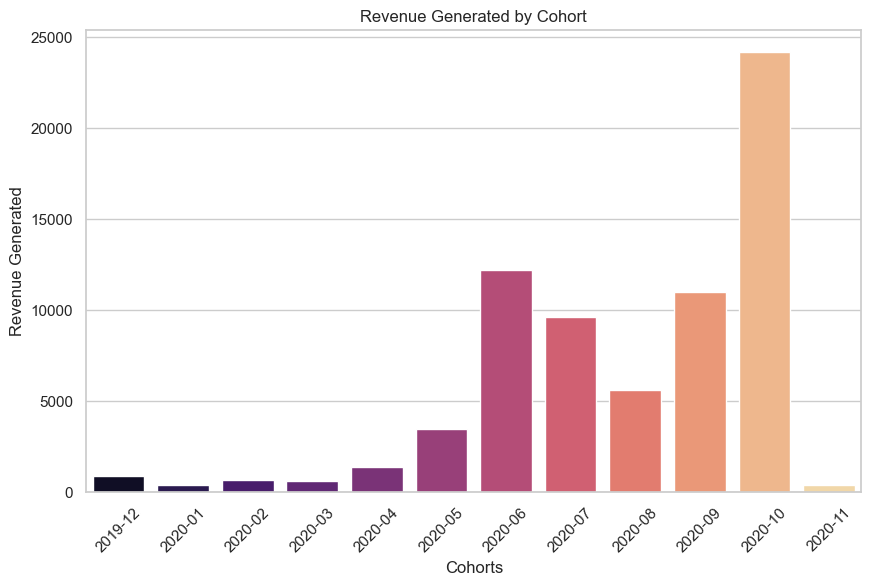

In [101]:
# plot the chart
# Create the count plot
plt.figure(figsize=(10, 6))
sns.barplot(data=revenue_per_cohort, x='Cohort', y='Fee Amount', palette="magma")

# Rotate x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Add labels and title
plt.xlabel('Cohorts')
plt.ylabel('Revenue Generated')
plt.title('Revenue Generated by Cohort')

# Show plot
plt.show()

In [102]:
# total capital lended
fee_per_user_id['Loan Amount'].sum()

1132673.0

In [103]:
# average % return on each loan
fee_per_user_id['% Return on Loan'].mean()

8.138399051298506

In [104]:
#Exporting to excel
fee_per_user_id.to_excel('%Return per loan and user id.xlsx')

In [105]:
merged_df.head(3)

,cash_request_id,Loan Amount,Status CR,Created at CR,updated_at_x,user_id,Num. of CR,Cohort,Num. of incidents,moderated_at,...,Status Fees,category,Fee Amount,reason,Created at Fees,updated_at_y,paid_at,from_date,to_date,charge_moment
0,4.0,100.0,money_back,2019-12-09 14:47:35.190714+00,2020-11-04 12:54:52.120014+00,NaN,None,None,None,2019-12-09 14:58:28+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,9.0,100.0,money_back,2019-12-10 19:14:41.668754+00,2020-11-04 12:55:30.918436+00,430.0,8,2019-12,None,2019-12-11 09:50:51+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,11.0,100.0,money_back,2019-12-10 19:18:35.805897+00,2020-11-04 12:55:36.25624+00,735.0,7,2019-12,None,2019-12-11 16:53:50.943562+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [106]:
# how many CRs per cohort we have
plot1 = merged_df.groupby("Cohort")['cash_request_id'].nunique().reset_index()
plot1

,Cohort,cash_request_id
0,2019-12,542
1,2020-01,188
2,2020-02,341
3,2020-03,259
4,2020-04,570
5,2020-05,1113
6,2020-06,3079
7,2020-07,2161
8,2020-08,937
9,2020-09,1766


C:\Users\drago\AppData\Local\Temp\ipykernel_30376\3831470522.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=plot1, x='Cohort', y='cash_request_id', palette="magma")


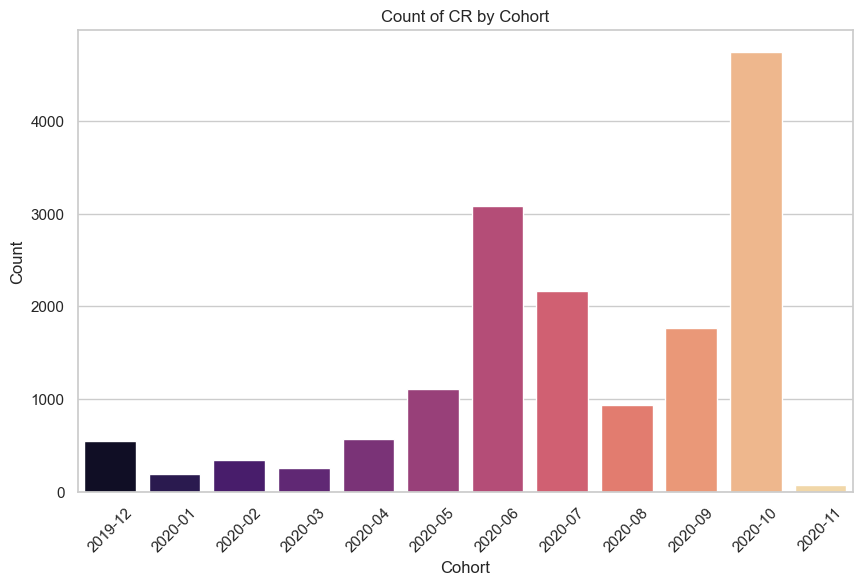

In [107]:
# Create the count plot
plt.figure(figsize=(10, 6))
sns.barplot(data=plot1, x='Cohort', y='cash_request_id', palette="magma")

# Rotate x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Add labels and title
plt.xlabel('Cohort')
plt.ylabel('Count')
plt.title('Count of CR by Cohort')

# Show plot
plt.show()

In [108]:
# How many users are in each cohort
users_per_cohort = merged_df.groupby("Cohort")['user_id'].nunique().reset_index()
users_per_cohort

,Cohort,user_id
0,2019-12,123
1,2020-01,43
2,2020-02,62
3,2020-03,62
4,2020-04,157
5,2020-05,322
6,2020-06,1017
7,2020-07,871
8,2020-08,485
9,2020-09,1240


C:\Users\drago\AppData\Local\Temp\ipykernel_30376\619286206.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=users_per_cohort, x='Cohort', y='user_id', palette="magma")


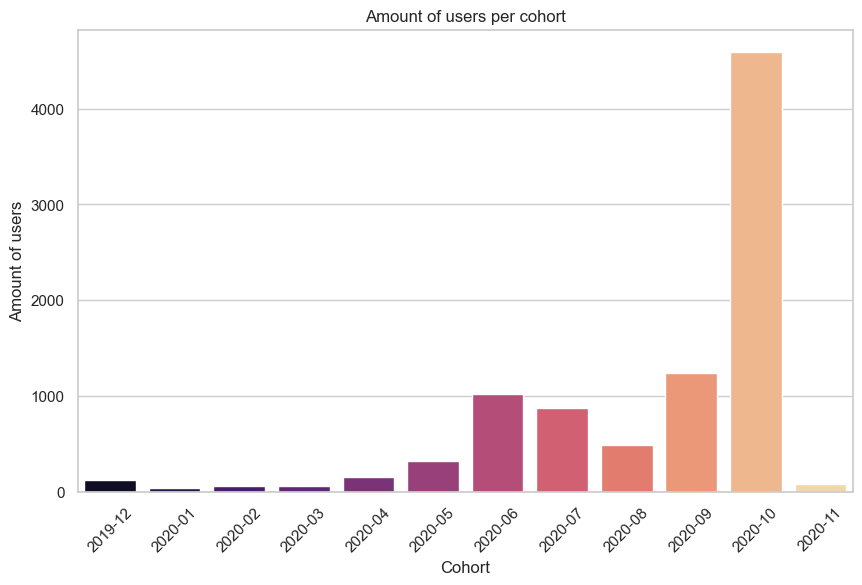

In [109]:
# Create the count plot
plt.figure(figsize=(10, 6))
sns.barplot(data=users_per_cohort, x='Cohort', y='user_id', palette="magma")

# Rotate x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Add labels and title
plt.xlabel('Cohort')
plt.ylabel('Amount of users')
plt.title('Amount of users per cohort')

# Show plot
plt.show()

In [110]:
#Incident rate for each cohort
# inside of each cohort, for each user, get the number of incidents 
plot2 = merged_df[['Cohort', 'Num. of incidents']].groupby(['Cohort']).sum()
plot2 = plot2.reset_index()
plot2


,Cohort,Num. of incidents
0,2019-12,0
1,2020-01,39
2,2020-02,31
3,2020-03,36
4,2020-04,48
5,2020-05,118
6,2020-06,380
7,2020-07,60
8,2020-08,44
9,2020-09,11


In [111]:
# merging to do some math
plot2 = plot2.merge(users_per_cohort, left_on='Cohort', right_on='Cohort')
plot2

,Cohort,Num. of incidents,user_id
0,2019-12,0,123
1,2020-01,39,43
2,2020-02,31,62
3,2020-03,36,62
4,2020-04,48,157
5,2020-05,118,322
6,2020-06,380,1017
7,2020-07,60,871
8,2020-08,44,485
9,2020-09,11,1240


In [112]:
# getting the incident rate by dividing the number of incidents with the ammount of users in each cohort
plot2['Incident_rate'] =plot2['Num. of incidents'] / plot2['user_id']
plot2

,Cohort,Num. of incidents,user_id,Incident_rate
0,2019-12,0,123,0.0
1,2020-01,39,43,0.906977
2,2020-02,31,62,0.5
3,2020-03,36,62,0.580645
4,2020-04,48,157,0.305732
5,2020-05,118,322,0.36646
6,2020-06,380,1017,0.373648
7,2020-07,60,871,0.068886
8,2020-08,44,485,0.090722
9,2020-09,11,1240,0.008871


In [116]:
plot2.to_excel('Incident_rate_by_cohort.xlsx')

C:\Users\drago\AppData\Local\Temp\ipykernel_30376\739322242.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=plot2, x='Cohort', y='Incident_rate', palette="magma")


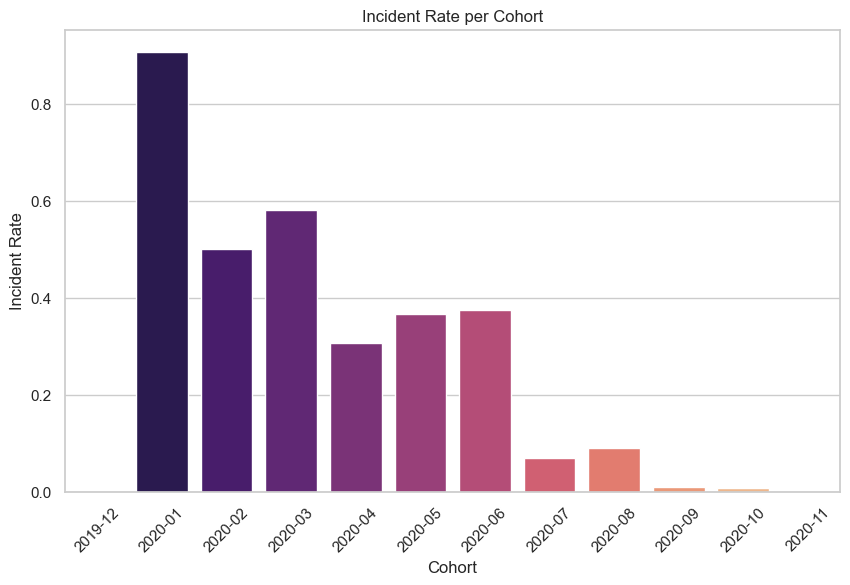

In [114]:
# Create the count plot
plt.figure(figsize=(10, 6))
sns.barplot(data=plot2, x='Cohort', y='Incident_rate', palette="magma")

# Rotate x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Add labels and title
plt.xlabel('Cohort')
plt.ylabel('Incident Rate')
plt.title('Incident Rate per Cohort')

# Show plot
plt.show()

In [115]:
#THE END :)